In [1]:
from pathlib import Path
import time

from torchvision.models.detection import fasterrcnn_resnet50_fpn_v2
from tqdm.autonotebook import tqdm
import torch
from torch.utils.data import DataLoader

import torch
import torch.optim as optim
import torchvision
from torchvision.models.detection import fasterrcnn_resnet50_fpn_v2
from torchvision.transforms import functional as F
from torchvision.datasets import CocoDetection
from torch.utils.data import DataLoader
import torchvision.transforms as T

/tmp/ipykernel_23132/3216248496.py:5: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from tqdm.autonotebook import tqdm


In [2]:
USE_CPU = False

torch.cuda.is_available() 
device = torch.device('cuda') if torch.cuda.is_available() and not USE_CPU else torch.device('cpu')
print(device)

cuda


In [5]:
from hungarian_tracker import Hungarian_TrackerIoU

%load_ext autoreload
%autoreload 2
%matplotlib inline

In [7]:
model_dir = Path('./models')
model_dir.mkdir(parents=True, exist_ok=True)

obj_detect = fasterrcnn_resnet50_fpn_v2(pretrained=True)

# Replace the box predictor
num_classes = 2  # e.g., 2 for background + 1 object type
in_features = obj_detect.roi_heads.box_predictor.cls_score.in_features
obj_detect.roi_heads.box_predictor = torchvision.models.detection.faster_rcnn.FastRCNNPredictor(in_features, num_classes)

# Move to device
obj_detect.to(device)
obj_detect.load_state_dict(torch.load(model_dir.joinpath("fine_tuned_faster-rcnn.pth")))
obj_detect.eval()

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
       

In [8]:
tracker = Hungarian_TrackerIoU(obj_detect)

In [9]:
import os
from matplotlib import pyplot as plt
from torch.utils.data import DataLoader, Dataset
from tqdm import tqdm
import cv2
import torch
from PIL import Image

frame = 0
image_folder = './labeled_barcode_images/makeathon-reply.v1i.coco/train'
# Get all image file names
image_files = sorted([f for f in os.listdir(image_folder) if f.lower().endswith(('.png', '.jpg', '.jpeg'))])

def run_tracker_on_frames(frames_folder, tracker, device):
    """Run the tracker on a folder containing frames."""
    tracker.reset()

    # data_loader = train_loader

    # Process each frame
    print(f"Tracking frames in folder: {frames_folder}")
    for image_file in tqdm(image_files, desc="Processing images"):
        image_path = os.path.join(image_folder, image_file)
        image_bgr = cv2.imread(image_path)
        image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

        frame = F.to_tensor(Image.fromarray(image_rgb)).to(device)

        tracker.step([frame])
        
    # Get the resulting tracks
    results = tracker.get_results()
    print(f"Tracks found: {len(results)}")
    return results

In [10]:
results = run_tracker_on_frames('./labeled_barcode_images/makeathon-reply.v1i.coco/train', tracker, device)

Tracking frames in folder: ./labeled_barcode_images/makeathon-reply.v1i.coco/train


Processing images: 100%|██████████| 80/80 [00:30<00:00,  2.65it/s]

Tracks found: 759


In [11]:
# print(results)

filtered_results = {k: v for k, v in results.items() if isinstance(v, dict) and len(v) > 1}
# print(filtered_results)

summary = {k: len(v) for k, v in filtered_results.items()}
# print(summary)

sorted_summary = dict(sorted(summary.items(), key=lambda item: item[1], reverse=True))
print(sorted_summary)

print(len(summary))

{285: 22, 293: 18, 272: 16, 276: 16, 296: 14, 298: 14, 269: 13, 306: 13, 364: 13, 366: 13, 367: 13, 288: 12, 295: 12, 363: 12, 386: 12, 389: 12, 268: 11, 278: 11, 310: 11, 370: 11, 374: 11, 395: 11, 286: 10, 307: 10, 388: 10, 390: 10, 392: 10, 393: 10, 415: 10, 277: 9, 289: 9, 396: 9, 398: 9, 403: 9, 404: 9, 408: 9, 412: 9, 417: 9, 287: 8, 291: 8, 297: 8, 409: 8, 410: 8, 411: 8, 413: 8, 416: 8, 361: 7, 397: 7, 423: 7, 607: 7, 270: 6, 280: 6, 305: 6, 312: 6, 313: 6, 387: 6, 402: 6, 406: 6, 418: 6, 420: 6, 424: 6, 432: 6, 468: 6, 628: 6, 629: 6, 635: 6, 638: 6, 639: 6, 643: 6, 644: 6, 647: 6, 649: 6, 655: 6, 659: 6, 271: 5, 292: 5, 294: 5, 303: 5, 304: 5, 308: 5, 309: 5, 314: 5, 315: 5, 341: 5, 342: 5, 351: 5, 401: 5, 414: 5, 426: 5, 427: 5, 429: 5, 431: 5, 435: 5, 437: 5, 438: 5, 440: 5, 448: 5, 469: 5, 470: 5, 472: 5, 473: 5, 475: 5, 476: 5, 611: 5, 662: 5, 667: 5, 668: 5, 670: 5, 673: 5, 674: 5, 675: 5, 676: 5, 677: 5, 679: 5, 157: 4, 258: 4, 266: 4, 283: 4, 284: 4, 316: 4, 322: 4, 32

In [12]:
print(results[114])

{6: array([3.6716765e+03, 2.5180806e+03, 3.7110195e+03, 2.5579141e+03,
       1.7195866e-01], dtype=float32), 7: array([3.7062319e+03, 2.4261619e+03, 3.7379700e+03, 2.4614956e+03,
       1.7195866e-01], dtype=float32)}


Processing images:   8%|▊         | 6/80 [00:01<00:15,  4.86it/s]

6


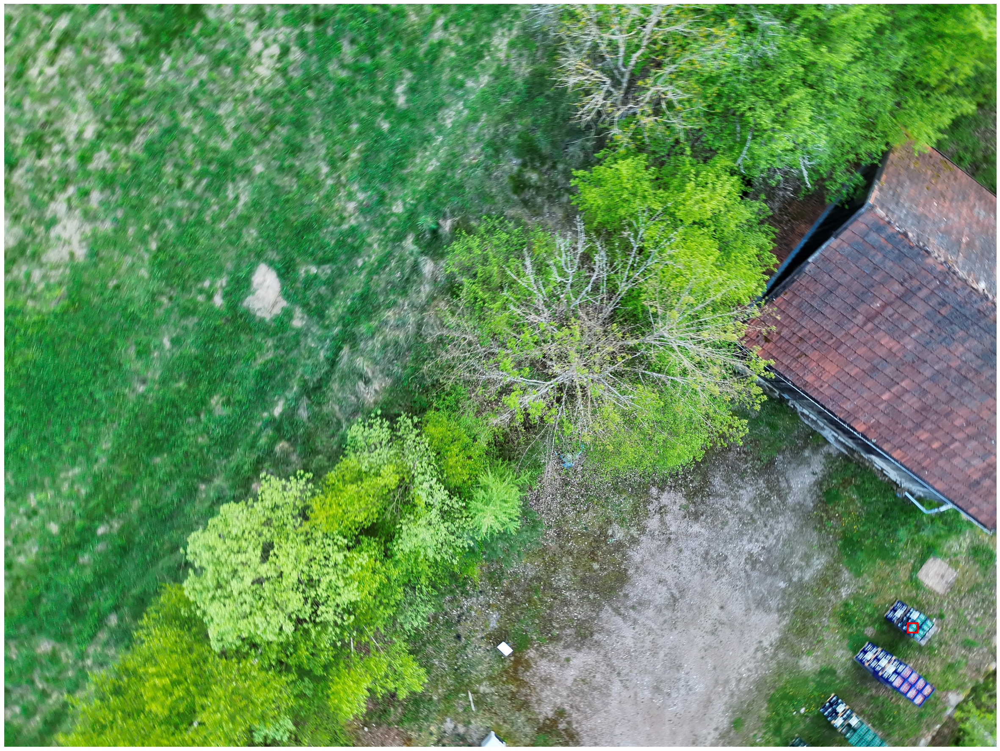

Processing images:   9%|▉         | 7/80 [00:03<01:02,  1.16it/s]

7


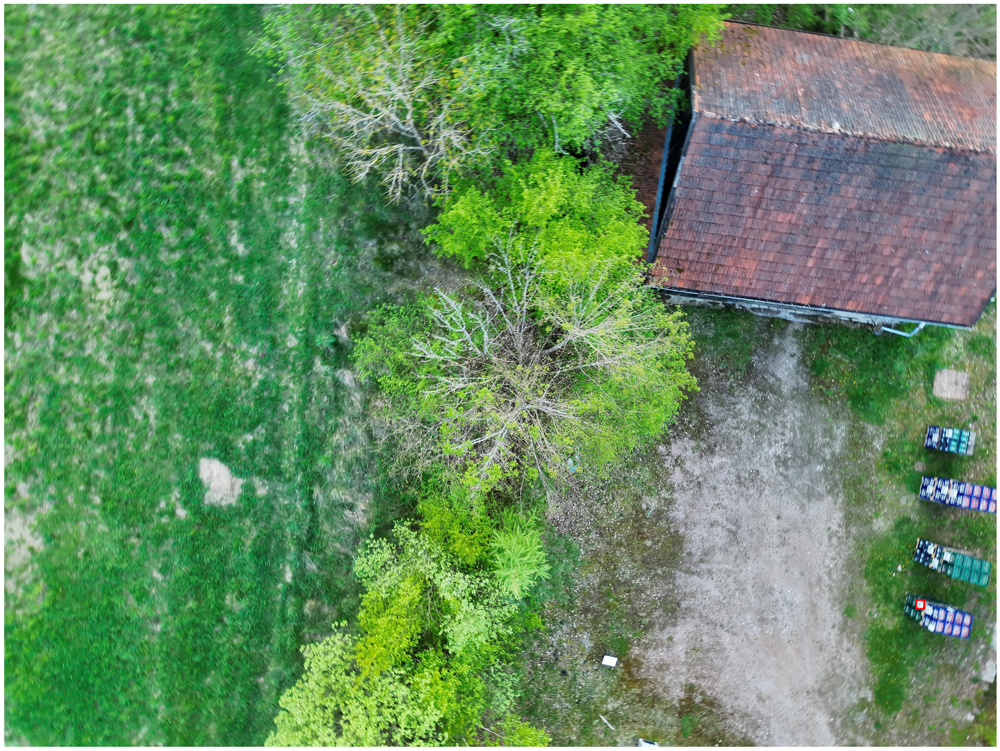

Processing images: 100%|██████████| 80/80 [00:20<00:00,  3.83it/s]


In [13]:
from PIL import Image
idx = 114

frame = 0
image_folder = './labeled_barcode_images/makeathon-reply.v1i.coco/train'
# Get all image file names
image_files = sorted([f for f in os.listdir(image_folder) if f.lower().endswith(('.png', '.jpg', '.jpeg'))])


for image_file in tqdm(image_files, desc="Processing images"):
    image_path = os.path.join(image_folder, image_file)
    image_bgr = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

    img = F.to_tensor(Image.fromarray(image_rgb)).to(device)
    
    if frame in results[idx].keys():
        box = results[idx][frame][0:4]
        print(frame)
    
        dpi = 96
        fig, ax = plt.subplots(1, dpi=dpi)

        img = img.mul(255).permute(1, 2, 0).byte().cpu().numpy()
        width, height, _ = img.shape
        
        ax.imshow(img, cmap='gray')
        fig.set_size_inches(width / dpi, height / dpi) 

        rect = plt.Rectangle(
        (box[0], box[1]),
        box[2]-box[0],
        box[3]-box[1],
        fill=False,
        linewidth=3.0,
        color='red')
        ax.add_patch(rect)       

        plt.axis('off')
        plt.show()
    
    frame += 1